# Clustering

Perform clustering (hierarchical,K means clustering and DBSCAN) for the airlines data to obtain optimum number of clusters. 
Draw the inferences from the clusters obtained.

Data Description:
 
The file EastWestAirlinescontains information on passengers who belong to an airline’s frequent flier program. For each passenger the data include information on their mileage history and on different ways they accrued or spent miles in the last year. The goal is to try to identify clusters of passengers that have similar characteristics for the purpose of targeting different segments for different types of mileage offers

ID --Unique ID

Balance--Number of miles eligible for award travel

Qual_mile--Number of miles counted as qualifying for Topflight status

cc1_miles -- Number of miles earned with freq. flyer credit card in the past 12 months:
cc2_miles -- Number of miles earned with Rewards credit card in the past 12 months:
cc3_miles -- Number of miles earned with Small Business credit card in the past 12 months:

1 = under 5,000
2 = 5,000 - 10,000
3 = 10,001 - 25,000
4 = 25,001 - 50,000
5 = over 50,000

Bonus_miles--Number of miles earned from non-flight bonus transactions in the past 12 months

Bonus_trans--Number of non-flight bonus transactions in the past 12 months

Flight_miles_12mo--Number of flight miles in the past 12 months

Flight_trans_12--Number of flight transactions in the past 12 months

Days_since_enrolled--Number of days since enrolled in flier program

Award--whether that person had award flight (free flight) or not


 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as smf
import statsmodels.formula.api as sm
import scipy.stats as stats

from sklearn import linear_model
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.metrics import mean_squared_error, mean_squared_log_error

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
data = pd.read_excel(r"EastWestAirlines.xlsx",sheet_name = 'data',index_col=0)
print("Shape:",data.shape)
data.head()

Shape: (3999, 11)


,Balance,Qual_miles,cc1_miles,cc2_miles,cc3_miles,Bonus_miles,Bonus_trans,Flight_miles_12mo,Flight_trans_12,Days_since_enroll,Award?
ID#,,,,,,,,,,,
1,28143,0,1,1,1,174,1,0,0,7000,0
2,19244,0,1,1,1,215,2,0,0,6968,0
3,41354,0,1,1,1,4123,4,0,0,7034,0
4,14776,0,1,1,1,500,1,0,0,6952,0
5,97752,0,4,1,1,43300,26,2077,4,6935,1


### EDA and Data Visualization

In [4]:
print('\n Describe:');   print(data.describe())
print('\n Info:');   print(data.info())
print('\n Null values:');   print(data.isnull().sum())
print('\n Duplicated:');   print(data[data.duplicated()])


 Describe:
            Balance    Qual_miles    cc1_miles    cc2_miles    cc3_miles  \
count  3.999000e+03   3999.000000  3999.000000  3999.000000  3999.000000   
mean   7.360133e+04    144.114529     2.059515     1.014504     1.012253   
std    1.007757e+05    773.663804     1.376919     0.147650     0.195241   
min    0.000000e+00      0.000000     1.000000     1.000000     1.000000   
25%    1.852750e+04      0.000000     1.000000     1.000000     1.000000   
50%    4.309700e+04      0.000000     1.000000     1.000000     1.000000   
75%    9.240400e+04      0.000000     3.000000     1.000000     1.000000   
max    1.704838e+06  11148.000000     5.000000     3.000000     5.000000   

         Bonus_miles  Bonus_trans  Flight_miles_12mo  Flight_trans_12  \
count    3999.000000   3999.00000        3999.000000      3999.000000   
mean    17144.846212     11.60190         460.055764         1.373593   
std     24150.967826      9.60381        1400.209171         3.793172   
min        

## Variable check

### Find columns with the same values

In [5]:
# Find columns with the same values
columns_with_same_values = data.columns[data.nunique() == 1].tolist()

for column in columns_with_same_values:
    unique_values = data[column].unique()
    print(f"Unique values in the '{column}' column:")
    print(unique_values)
    print()

# excluding columns_with_same_values
data = data.drop(columns=columns_with_same_values)
print("excluded columns_with_same_values, nos:",columns_with_same_values ,",Final shape:", data.shape)

excluded columns_with_same_values, nos: [] ,Final shape: (3999, 11)


In [6]:
# Discrete Variables Count
discrete_feature=[feature for feature in data.columns if len(data[feature].unique())<20 and feature]
print('Discrete Variables Count: {}'.format(len(discrete_feature)))
print(discrete_feature)

# Continuous Feature Count
continuous_feature=[feature for feature in data.columns if data[feature].dtype!='O' and feature not in discrete_feature]
print('\nContinuous Feature Count {}'.format(len(continuous_feature)))
print(continuous_feature)

# Other Features Count
other_feature = [feature for feature in data.columns if feature not in discrete_feature and feature not in continuous_feature]
print('\nOther Features Count: {}'.format(len(other_feature)))
print('Other Features: {}'.format(other_feature))

# Numeric Data
numeric_data = data.select_dtypes(include='number')
print('\nNumeric Data Shape:', numeric_data.shape)
print(numeric_data.columns)

# Categorical Data
categorical_data = data.select_dtypes(include='object')
print('\nCategorical Data Shape:', categorical_data.shape)
print('Categorical Columns:', categorical_data.columns)

Discrete Variables Count: 4
['cc1_miles', 'cc2_miles', 'cc3_miles', 'Award?']

Continuous Feature Count 7
['Balance', 'Qual_miles', 'Bonus_miles', 'Bonus_trans', 'Flight_miles_12mo', 'Flight_trans_12', 'Days_since_enroll']

Other Features Count: 0
Other Features: []

Numeric Data Shape: (3999, 11)
Index(['Balance', 'Qual_miles', 'cc1_miles', 'cc2_miles', 'cc3_miles',
       'Bonus_miles', 'Bonus_trans', 'Flight_miles_12mo', 'Flight_trans_12',
       'Days_since_enroll', 'Award?'],
      dtype='object')

Categorical Data Shape: (3999, 0)
Categorical Columns: Index([], dtype='object')


## Categorical Data

Bar plot for all categorical

Labelencoder to convert categorical data into numeric

## Numeric Data

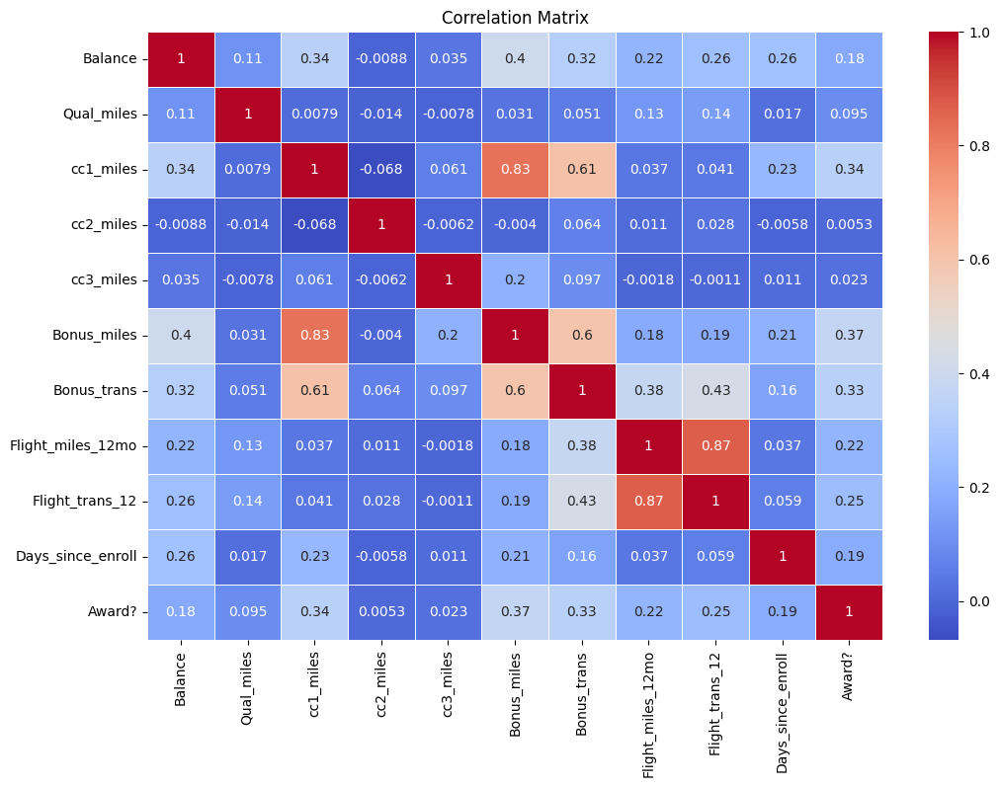

In [7]:
# Correlation Plot
corr_matrix = data.corr(numeric_only=True)
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

### visualization

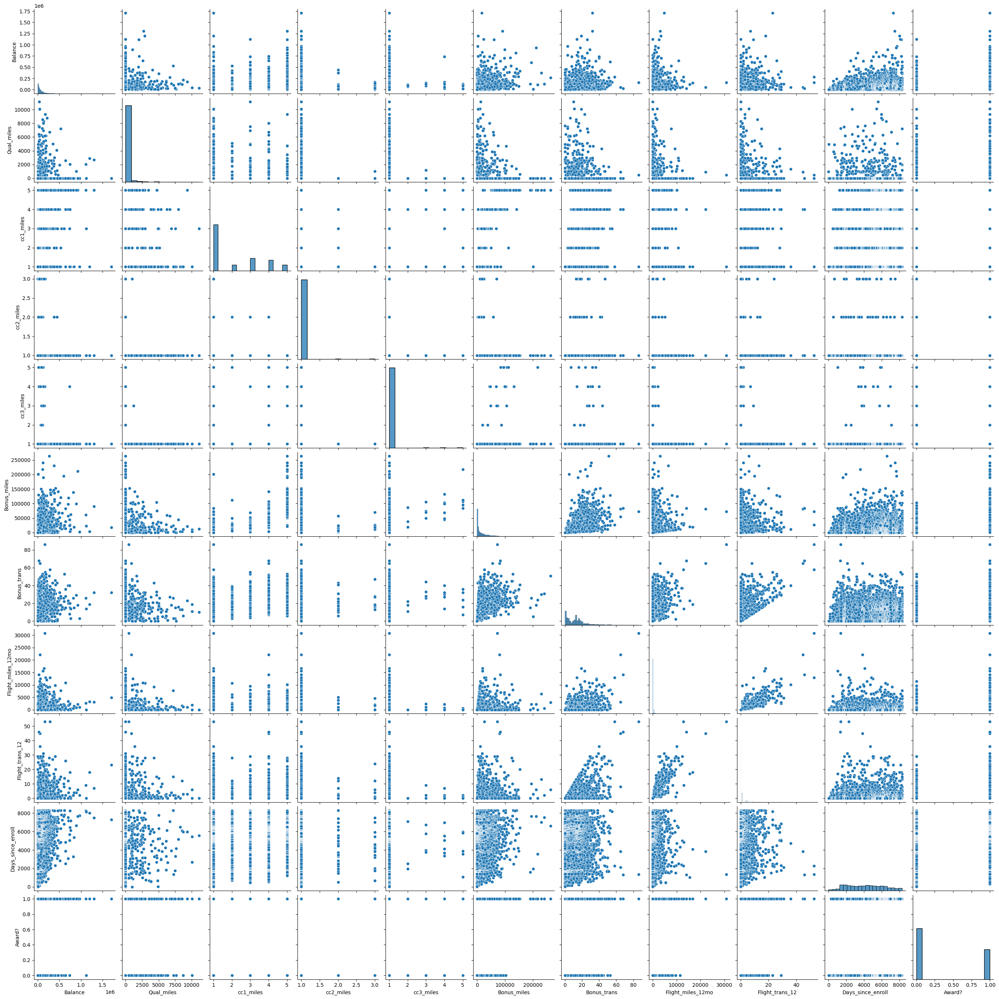

In [8]:
# relationship plot for numeric data
sns.pairplot(data= numeric_data)
plt.show()

### Detect outliers and handle them

In [9]:
data_filtered=pd.concat([numeric_data],axis=1)    #,cat_data ,numeric_data, data_2
data_filtered.shape

(3999, 11)

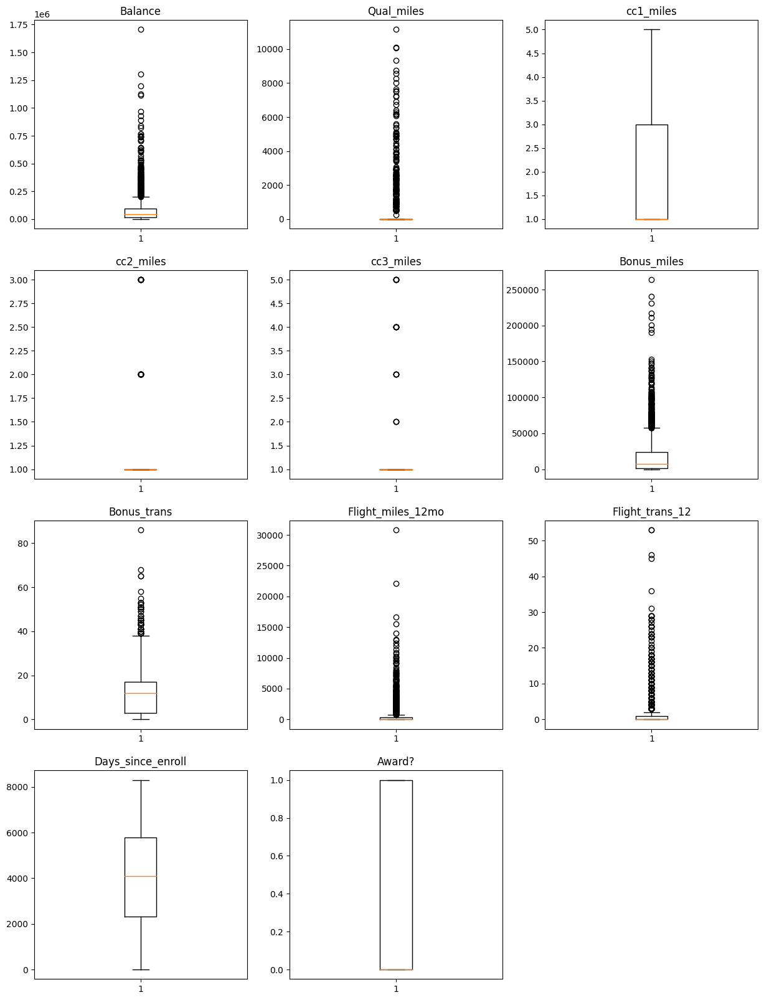

In [10]:
# display boxplots

num_columns = len(numeric_data.columns)
subplots_per_row = 3
num_rows = (num_columns + subplots_per_row - 1) // subplots_per_row

# Create subplots
fig, axes = plt.subplots(num_rows, subplots_per_row, figsize=(15, 5*num_rows))
axes = axes.flatten()

for i in range(num_columns):
    ax = axes[i]
    ax.boxplot(data_filtered.iloc[:, i])
    ax.set_title(data_filtered.columns[i])

# Hide any remaining empty subplots
for i in range(num_columns, num_rows * subplots_per_row):
    fig.delaxes(axes[i])

# plt.tight_layout()
plt.show()


#### Treating outliers with IQR

In [11]:
num_columns = len(numeric_data.columns)
new_data = data_filtered.copy()

for i in range(num_columns):
    # print("\n\nColumn Name:",(data_filtered.columns[i]))
    print("\n\nColumn Name: \033[1;34m" + "\033[1m" + data_filtered.columns[i] + "\033[0m")

    # Calculate the IQR
    Q1 = data_filtered.iloc[:, i].quantile(0.25)
    Q3 = data_filtered.iloc[:, i].quantile(0.75)
    IQR = Q3 - Q1
        
    # Identify and mark outliers using IQR
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    print(data_filtered[(data_filtered.iloc[:, i] > upper_bound) | (data_filtered.iloc[:, i] < lower_bound)].tail(2))
    
    # # Changing the outliers
    # new_data.loc[(new_data[data_filtered.columns[i]] > upper_bound), data_filtered.columns[i]] = upper_bound
    # new_data.loc[(new_data[data_filtered.columns[i]] < lower_bound), data_filtered.columns[i]] = lower_bound
    
    # # Drop rows with outliers
    # outliers = new_data[(new_data.iloc[:, i] < lower_bound) | (new_data.iloc[:, i] > upper_bound)].index   
    # new_data = new_data.drop(outliers)
    
print("\nShape of new data:",new_data.shape)
# sns.boxplot(data = new_data)
# plt.show()




Column Name: Balance
      Balance  Qual_miles  cc1_miles  cc2_miles  cc3_miles  Bonus_miles  \
ID#                                                                       
3811   374613           0          1          2          1        23592   
3862   204693           0          1          1          1         5159   

      Bonus_trans  Flight_miles_12mo  Flight_trans_12  Days_since_enroll  \
ID#                                                                        
3811           31               5000               14               3463   
3862            5                  0                0               1672   

      Award?  
ID#           
3811       1  
3862       0  


Column Name: Qual_miles
      Balance  Qual_miles  cc1_miles  cc2_miles  cc3_miles  Bonus_miles  \
ID#                                                                       
3979    47301        1005          1          1          1         4561   
3984   131125         862          1          1          1  

Note: not removing outliers, 

In [12]:
# # relationship plot for all data
# sns.pairplot(data= new_data)
# plt.show()

In [13]:
# to check repeatation iteration
# data_filtered=new_data

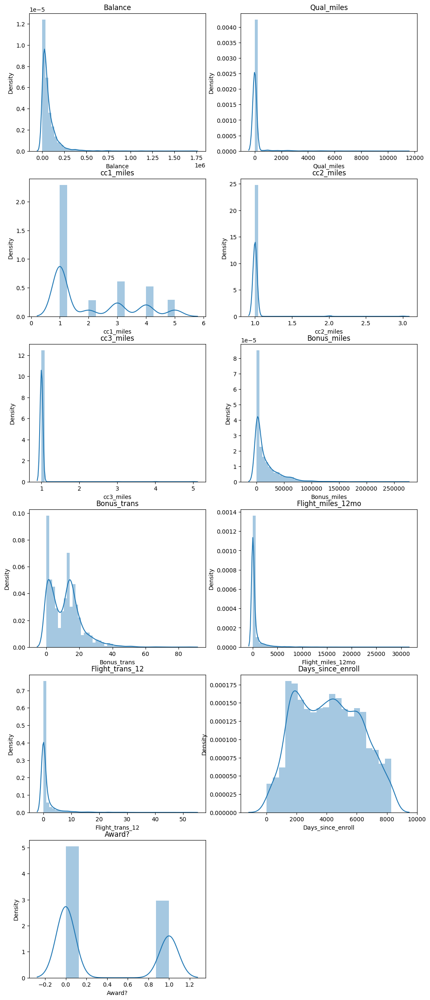

In [14]:
# distribution plots
subplots_per_row = 2
num_rows = (len(new_data.columns) + subplots_per_row - 1) // subplots_per_row
fig, axes = plt.subplots(num_rows, subplots_per_row, figsize=(12, 5*num_rows))
axes = axes.flatten()

for i, column in enumerate(new_data.columns):
    ax = axes[i]
    sns.distplot(new_data[column], kde=True, ax=ax)
    ax.set_title(column)
    
# Hide any remaining empty subplots
for i in range(len(new_data.columns), num_rows * subplots_per_row):
    fig.delaxes(axes[i])

# plt.tight_layout()
plt.show()


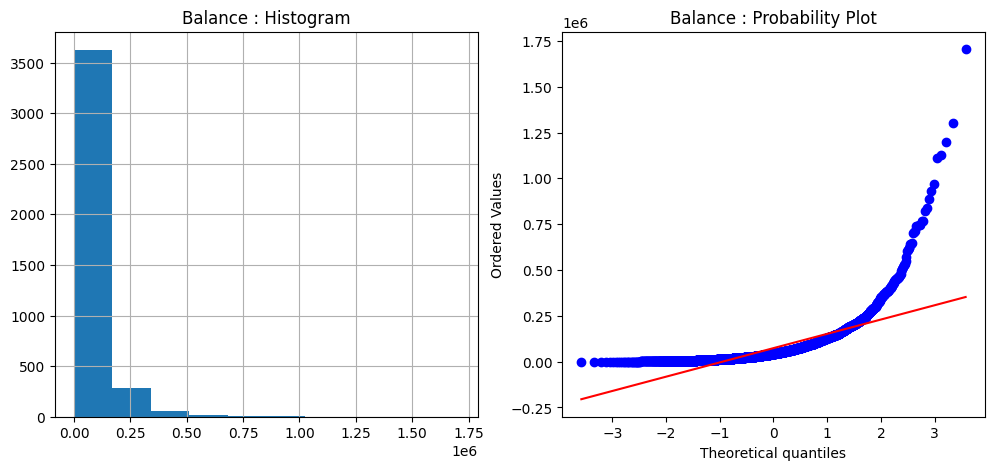

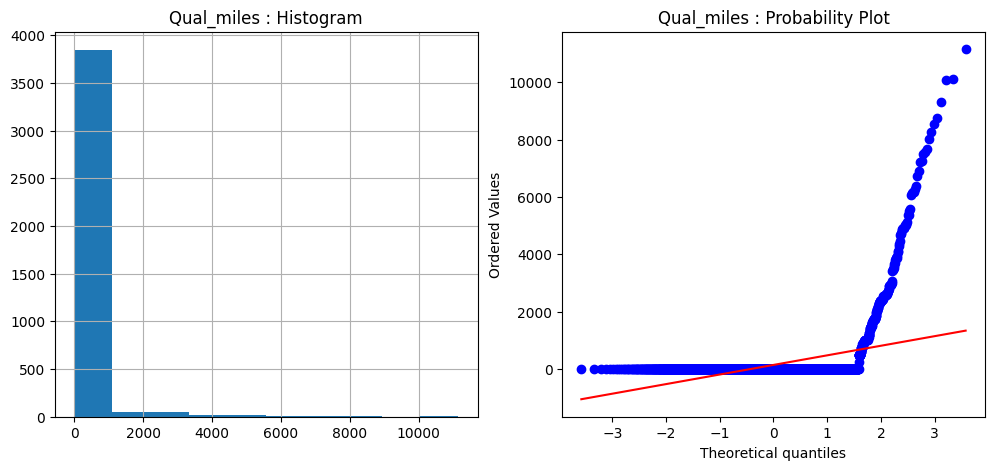

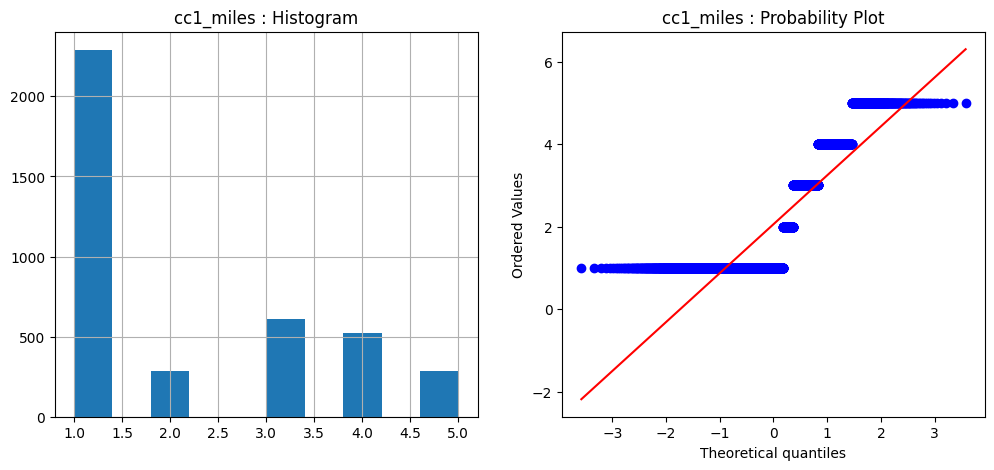

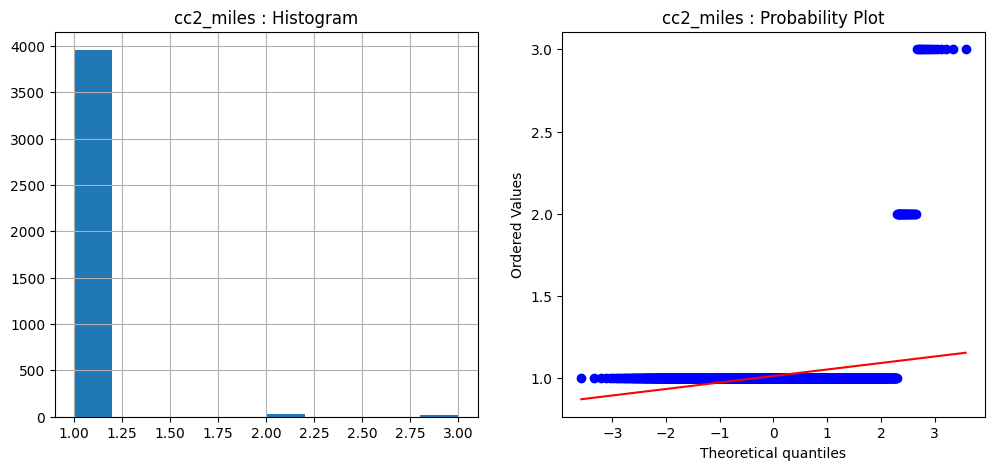

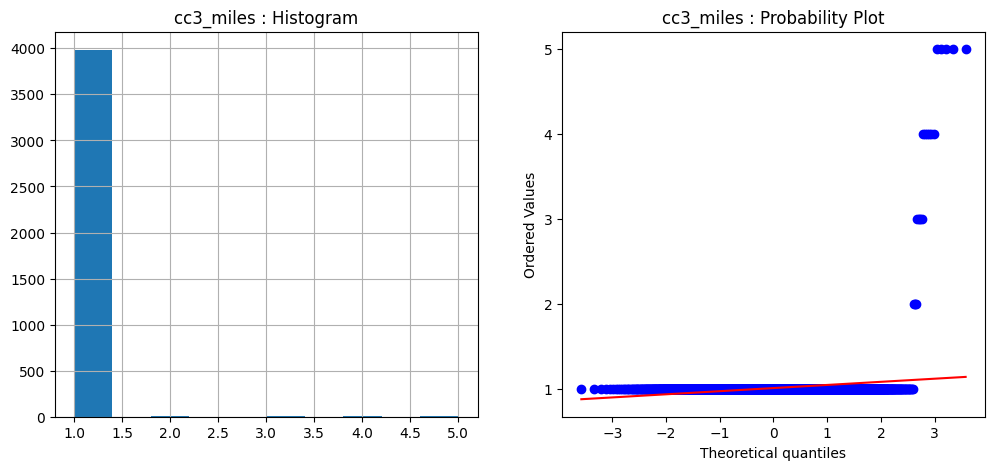

...

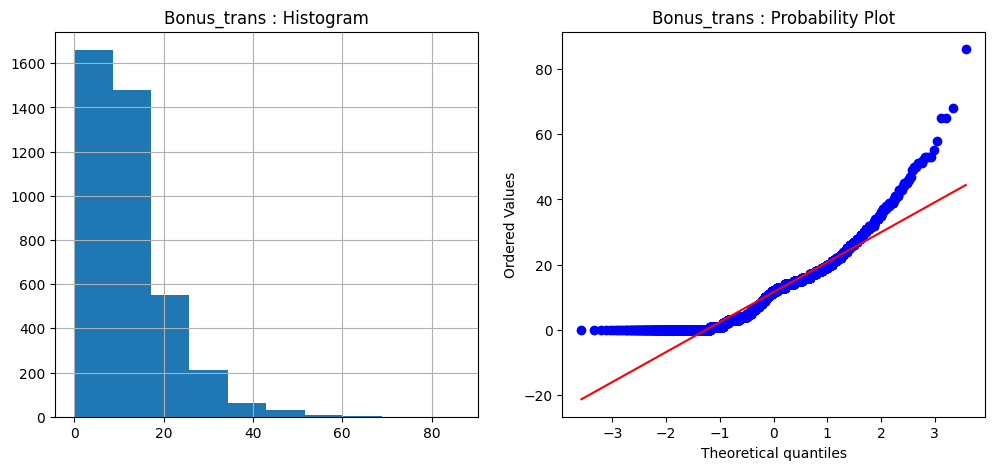

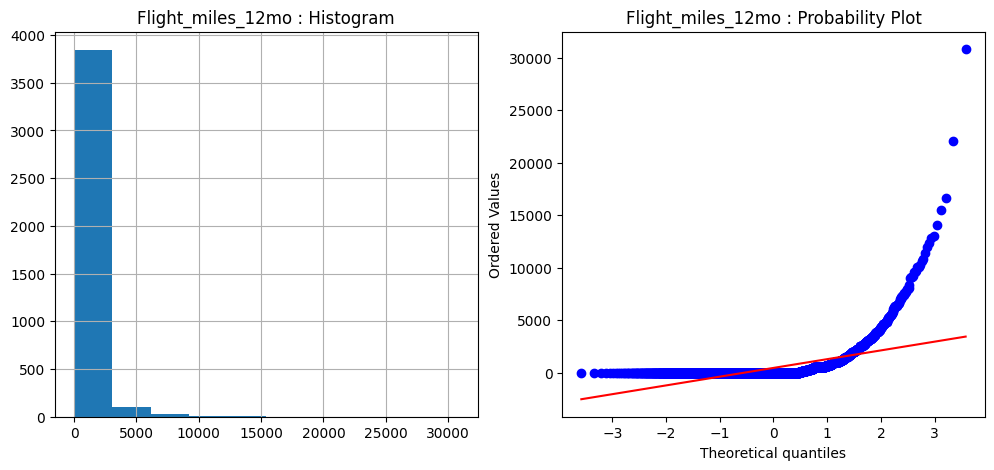

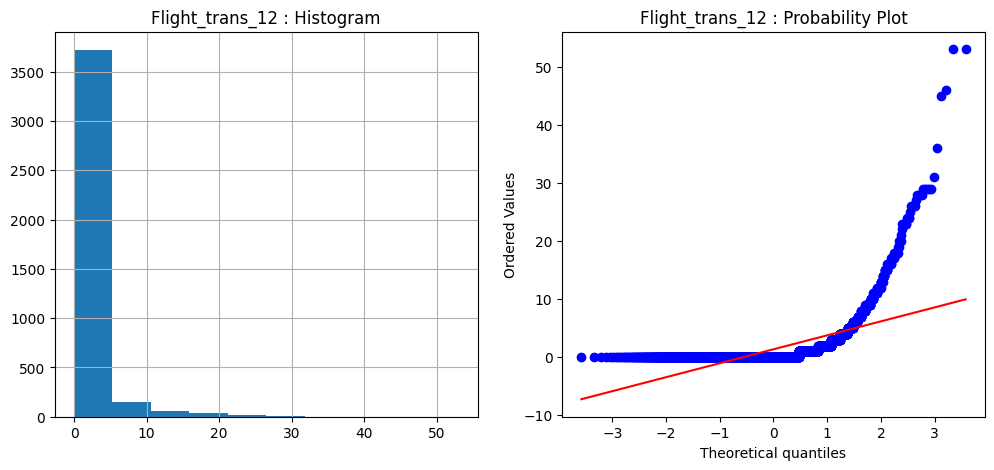

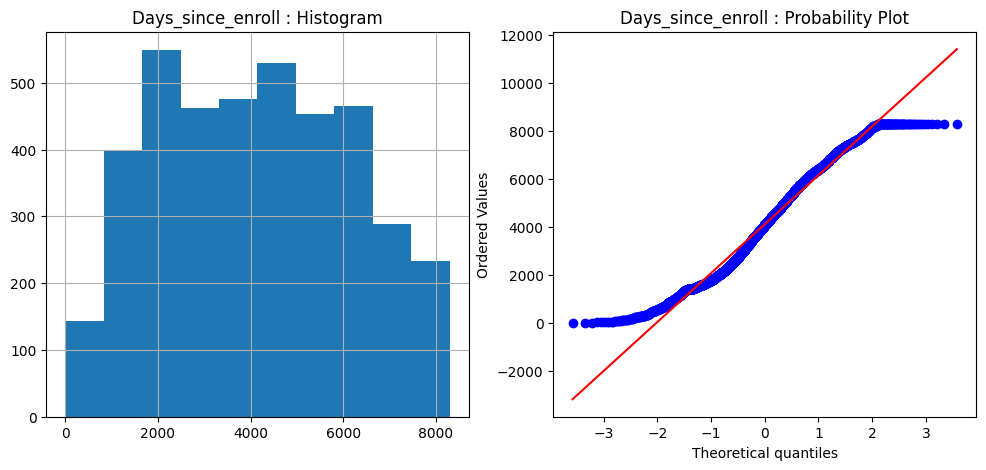

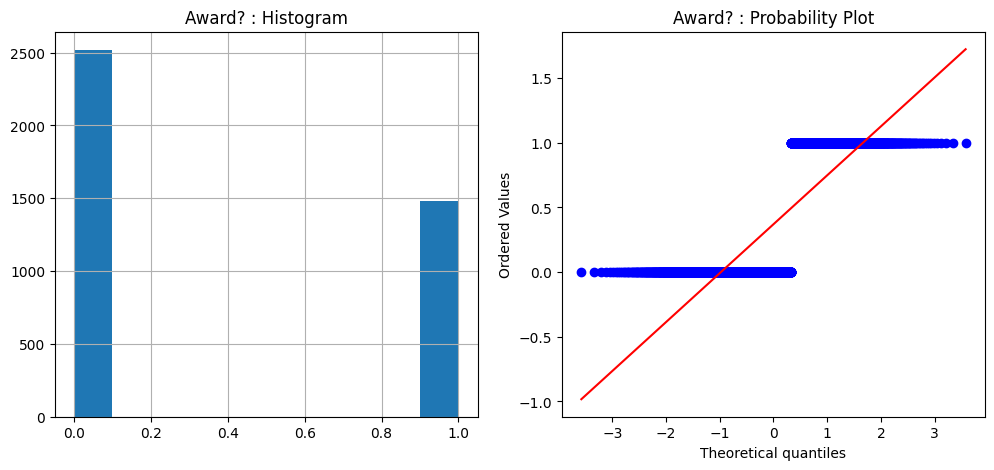

In [15]:
# Histogram & Probability Plot (Q-Q plot)
import pylab
import scipy.stats as stat

def plot_data(df, feature):
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    df[feature].hist()
    plt.title(f'{feature} : Histogram')
    plt.subplot(1, 2, 2)
    stat.probplot(df[feature], dist='norm', plot=pylab)
    plt.title(f'{feature} : Probability Plot')

# Iterate through all columns
for column in new_data.columns:
    plot_data(new_data, column)
    plt.show()


### Feature scaling

# Clustering

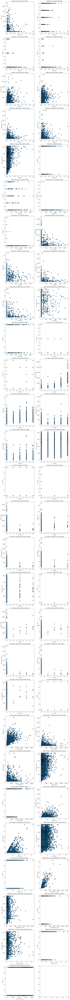

In [16]:
from scipy.special import comb
data_filtered = new_data
data_columns = data_filtered.columns
X=np.array(data_filtered)

num_columns = len(data_columns)
num_rows = int(np.ceil(comb(num_columns,2) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 6 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j:  # Avoid plotting the same column against itself
            row_index = count // 2
            col_index = count % 2
            count+=1
            # Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], cmap='viridis', s=50, edgecolors='k')  
            axes[row_index, col_index].set_title(f'{col1} vs {col2} by Cluster')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)


# Adjust layout
plt.tight_layout()
plt.show()


## hierarchical clustering

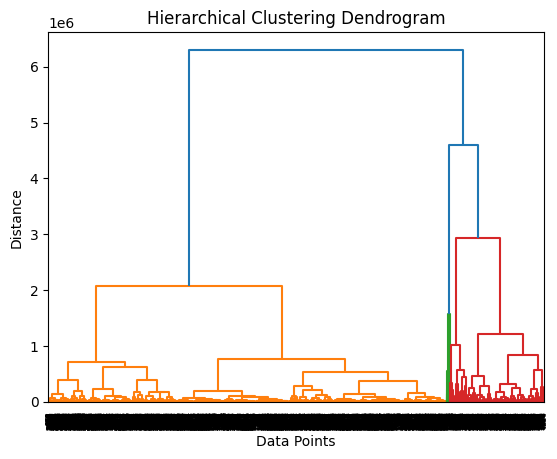

clusters: [2 2 2 ... 4 4 2] 
 Counts: (array([0, 1, 2, 3, 4, 5], dtype=int64), array([ 624,  134, 2185,    5, 1030,   21], dtype=int64))


In [17]:
# Import necessary libraries
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

# Hierarchical clustering
df = new_data

# Linkage matrix
linkage_matrix = linkage(df, method='ward')     # method='complete'

# Dendrogram
dendrogram(linkage_matrix)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.show()

# Agglomerative clustering
n_clusters = 6  # You can change the number of clusters as needed
agg_clustering = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')   #affinity='euclidean', linkage='complete'
df['labels_pred'] = agg_clustering.fit_predict(df)
data_filtered['HC_labels_pred'] = agg_clustering.fit_predict(df)
labels_pred = agg_clustering.fit_predict(df)
print("clusters:",labels_pred, "\n Counts:",np.unique(labels_pred, return_counts=True))
cluster_column = 'labels_pred' 

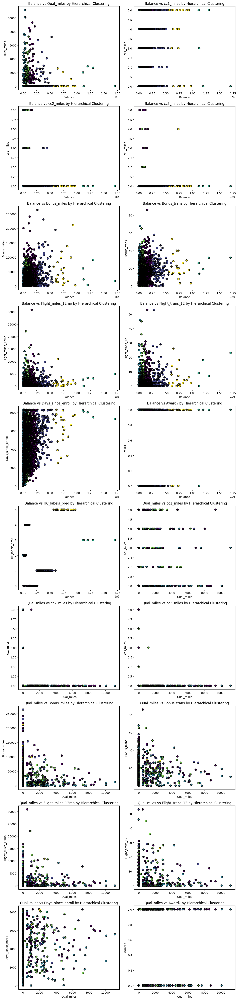

In [18]:
# Plot with Label Number
from scipy.special import comb
data_columns = df.columns[df.columns != cluster_column]
X=np.array(df)

num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j :  # Avoid plotting the same column against itself
            row_index = (count) // 2
            col_index = count % 2
            count=count+1
            if count > 20:
                break  # Exit the loop when count exceeds 20
            # Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            # Add cluster labels to each point
            for k, label in enumerate(labels_pred):
                axes[row_index, col_index].text(X[k, i], X[k, j], str(label), fontsize=8, ha='center', va='center')
            axes[row_index, col_index].set_title(f'{col1} vs {col2} by Hierarchical Clustering')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)

# Adjust layout
plt.tight_layout()
plt.show()


### visualize with 3d plot

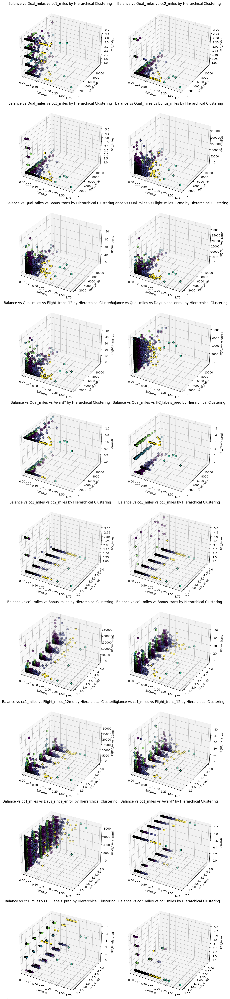

In [19]:
from mpl_toolkits.mplot3d import Axes3D

X=np.array(df)

num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows), subplot_kw={'projection': '3d'})

count=0
for i in range(num_columns):
    for j in range(i + 1, num_columns):
        for k in range(j + 1, num_columns):
            row_index = count // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # 3D Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], X[:, k], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            axes[row_index, col_index].set_title(f'{data_columns[i]} vs {data_columns[j]} vs {data_columns[k]} by Hierarchical Clustering')
            axes[row_index, col_index].set_xlabel(f'{data_columns[i]}')
            axes[row_index, col_index].set_ylabel(f'{data_columns[j]}')
            axes[row_index, col_index].set_zlabel(f'{data_columns[k]}')
            # axes[row_index, col_index].set_xlim([np.min(X[:, i]), np.max(X[:, i])])
            # axes[row_index, col_index].set_ylim([np.min(X[:, j]), np.max(X[:, j])])
            # axes[row_index, col_index].set_zlim([np.min(X[:, k]), np.max(X[:, k])])
            

# Adjust layout
plt.tight_layout()
plt.show()


With Normalization Data

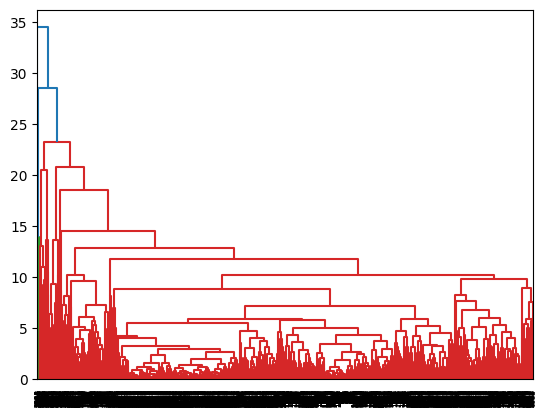

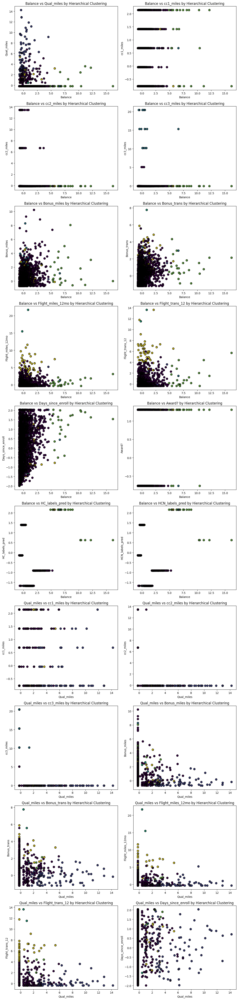

3D plot


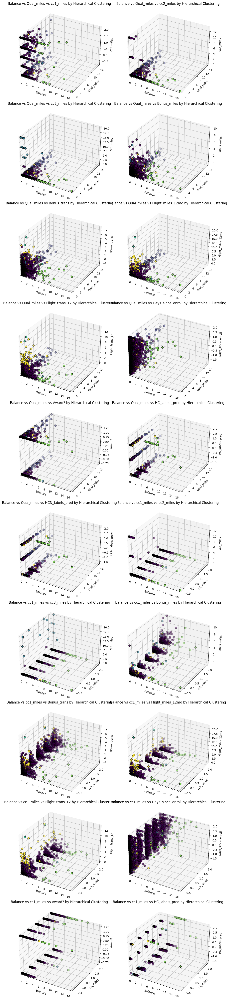

In [20]:
# With Normalization - Clustering 
from sklearn.preprocessing import StandardScaler
Norm = StandardScaler()    #Normalizer()        #
X = Norm.fit_transform(df)
dendrograms = dendrogram(linkage(X, method='complete'))
model = AgglomerativeClustering(n_clusters=6,affinity='euclidean', linkage='complete')
labels_pred = model.fit_predict(X)
data_filtered['HCN_labels_pred'] = labels_pred

 #Plot the clusters
data_columns = df.columns[df.columns != cluster_column]

num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j :  # Avoid plotting the same column against itself
            row_index = (count) // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            # Add cluster labels to each point
            for k, label in enumerate(labels_pred):
                axes[row_index, col_index].text(X[k, i], X[k, j], str(label), fontsize=8, ha='center', va='center')
            axes[row_index, col_index].set_title(f'{col1} vs {col2} by Hierarchical Clustering')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)


# Adjust layout
plt.tight_layout()
plt.show()


# 3D plot
print("3D plot")
num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows), subplot_kw={'projection': '3d'})

count=0
for i in range(num_columns):
    for j in range(i + 1, num_columns):
        for k in range(j + 1, num_columns):
            row_index = count // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # 3D Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], X[:, k], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            axes[row_index, col_index].set_title(f'{data_columns[i]} vs {data_columns[j]} vs {data_columns[k]} by Hierarchical Clustering')
            axes[row_index, col_index].set_xlabel(f'{data_columns[i]}')
            axes[row_index, col_index].set_ylabel(f'{data_columns[j]}')
            axes[row_index, col_index].set_zlabel(f'{data_columns[k]}')
            axes[row_index, col_index].set_xlim([np.min(X[:, i]), np.max(X[:, i])])
            axes[row_index, col_index].set_ylim([np.min(X[:, j]), np.max(X[:, j])])
            axes[row_index, col_index].set_zlim([np.min(X[:, k]), np.max(X[:, k])])
            

# Adjust layout
plt.tight_layout()
plt.show()


## K_means clustering

In [21]:
from sklearn.cluster import KMeans
df = new_data
X=np.array(df)
kmeans = KMeans(n_clusters=6, random_state=42)
labels_pred = kmeans.fit_predict(X)
print("Labels:" , labels_pred, "\n Counts:",np.unique(labels_pred, return_counts=True))
df['labels_pred'] = labels_pred 
data_filtered['Kmeans_labels_pred'] = labels_pred

Labels: [1 1 1 ... 0 1 1] 
 Counts: (array([0, 1, 2, 3, 4, 5]), array([1103, 2273,   23,  478,  117,    5], dtype=int64))


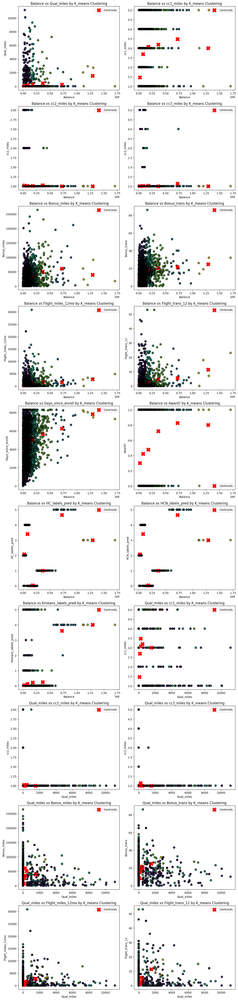

3D plot


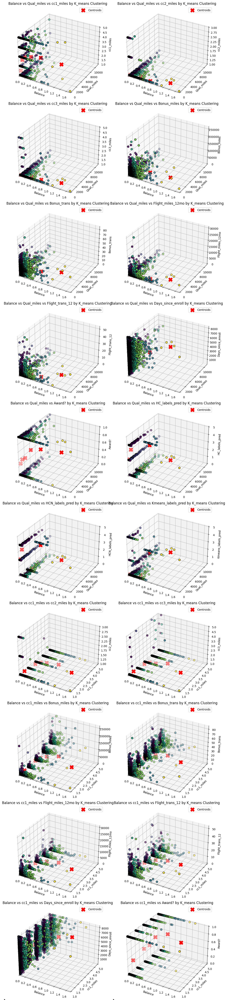

In [22]:
#Plot the clusters
data_columns = df.columns[df.columns != cluster_column]
num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j :  # Avoid plotting the same column against itself
            row_index = (count) // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], c=labels_pred, cmap='viridis', s=50, edgecolors='k')
            axes[row_index, col_index].scatter(kmeans.cluster_centers_[:, i], kmeans.cluster_centers_[:, j], c='red', marker='X', s=200, label='Centroids')
            axes[row_index, col_index].legend()

            # Add cluster labels to each point
            for k, label in enumerate(labels_pred):
                axes[row_index, col_index].text(X[k, i], X[k, j], str(label), fontsize=8, ha='center', va='center')
            axes[row_index, col_index].set_title(f'{col1} vs {col2} by K_means Clustering')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)
                        

# Adjust layout
plt.tight_layout()
plt.show()


# 3D plot
print("3D plot")
num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows), subplot_kw={'projection': '3d'})

count=0
for i in range(num_columns):
    for j in range(i + 1, num_columns):
        for k in range(j + 1, num_columns):
            row_index = count // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # 3D Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], X[:, k], c=labels_pred, cmap='viridis', s=50, edgecolors='k')
            axes[row_index, col_index].scatter(kmeans.cluster_centers_[:, i], kmeans.cluster_centers_[:, j], kmeans.cluster_centers_[:, k], c='red', marker='X', s=200, label='Centroids')
            axes[row_index, col_index].legend()
            axes[row_index, col_index].set_title(f'{data_columns[i]} vs {data_columns[j]} vs {data_columns[k]} by K_means Clustering')
            axes[row_index, col_index].set_xlabel(f'{data_columns[i]}')
            axes[row_index, col_index].set_ylabel(f'{data_columns[j]}')
            axes[row_index, col_index].set_zlabel(f'{data_columns[k]}')
            axes[row_index, col_index].set_xlim([np.min(X[:, i]), np.max(X[:, i])])
            axes[row_index, col_index].set_ylim([np.min(X[:, j]), np.max(X[:, j])])
            axes[row_index, col_index].set_zlim([np.min(X[:, k]), np.max(X[:, k])])
                     

# Adjust layout
plt.tight_layout()
plt.show()

### Elbow Method - to find the optimal number of clusters (k)

Plot the sum of squared distances (inertia) for different values of k.  
Look for the "elbow" point where the rate of decrease slows down.   
The point where adding more clusters provides diminishing returns is often a good choice for k.

[42961820061912.99, 20823632655848.824, 11792330355973.883, 7549630974902.119, 5724519516912.957, 4541450680422.304, 3697283844405.4844, 3272073210726.956, 2897498741384.3354, 2633371424334.506]


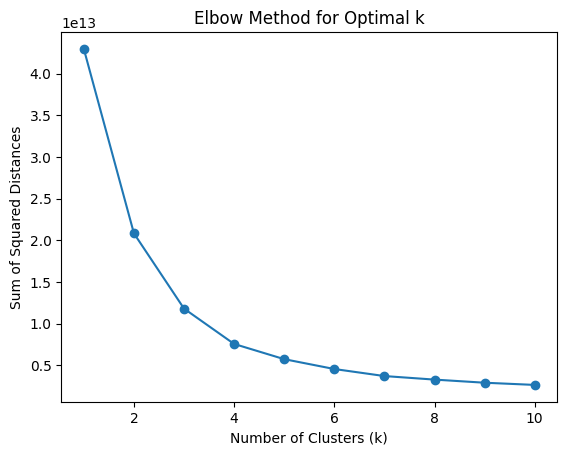

In [23]:
# Calculate sum of squared distances for different values of k
inertia_values = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertia_values.append(kmeans.inertia_)    
print(inertia_values)

# Plot the elbow graph
plt.plot(range(1, 11), inertia_values, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Distances')
plt.show()

### Silhouette Score - to find the optimal number of clusters (k)

Compute the silhouette score for different values of k.     
Choose the k with the highest silhouette score, where values range from -1 to 1, and higher values indicate better-defined clusters.

0.74189621519371
0.6496045195646818
0.5906749466316791
0.5420609373103873
0.5153976407344492
0.47304812736950497
0.47002252405398165
0.44112662891776044
0.44769553632288817


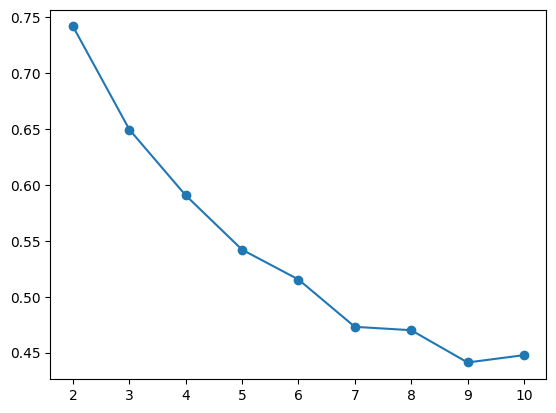

In [24]:
from sklearn.metrics import silhouette_score
silhouette_scores = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X)
    score=silhouette_score(X, labels)
    print(score)
    silhouette_scores.append(score)
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.show()


### Davies-Bouldin Index - to find the optimal number of clusters (k)

A lower Davies-Bouldin index indicates better clustering.       
Iterate over different values of k and choose the one that minimizes the Davies-Bouldin index.

0.6322390892130421


0.6039691962900154
0.6207850982498625
0.659674739267712
0.6451947321880346
0.7024541375325113
0.7401032250961831
0.747914188607609
0.7665648870397327


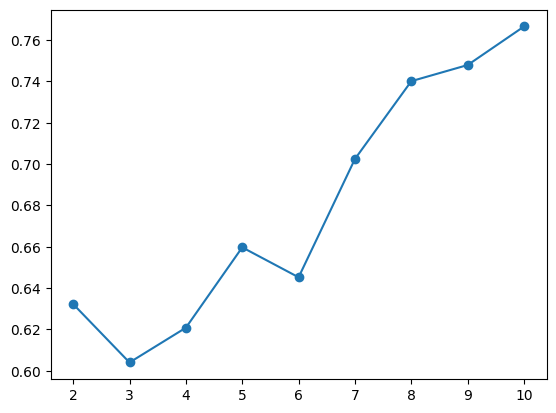

In [25]:
from sklearn.metrics import davies_bouldin_score
db_scores = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X)
    score=davies_bouldin_score(X, labels)
    print(score)
    db_scores.append(score)
plt.plot(range(2, 11), db_scores, marker='o')
plt.show()


Note: Best clustering number is two

## DBScan clustering

Labels: [0 0 0 ... 2 7 0] 
 Counts: (array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8], dtype=int64), array([ 875, 1432,  550,  275,  487,  187,   42,   73,   55,   23],
      dtype=int64))


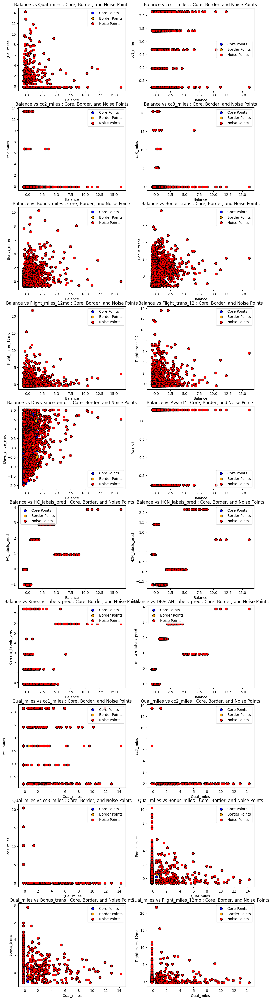

In [26]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

df = new_data
# df.drop(['Unnamed: 0'],axis=1,inplace=True)
# X=np.array(df)
stscaler = StandardScaler()
X = stscaler.fit_transform(df)
dbscan = DBSCAN(eps=1, min_samples=10)
dbscan.fit_predict(X)

# Extract cluster labels and outliers #Noisy samples are given the label -1.
labels_pred=dbscan.labels_
print("Labels:" , labels_pred, "\n Counts:",np.unique(labels_pred, return_counts=True))
df['labels_pred'] = labels_pred
data_filtered['DBSCAN_labels_pred'] = labels_pred

# Identify core, border, and noise points
core_samples_mask = np.zeros_like(labels_pred, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
border_samples_mask = (labels_pred != -1) & ~core_samples_mask
noise_samples_mask = (labels_pred == -1)

df1=X
# Plot the points with different colors for core, border, and noise points
data_columns = df.columns[df.columns != cluster_column]

num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j :  # Avoid plotting the same column against itself
            row_index = (count) // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # Scatter plot
            axes[row_index, col_index].scatter(df1[core_samples_mask, i], df1[core_samples_mask, j], c='blue', s=50, edgecolors='k', label='Core Points')
            axes[row_index, col_index].scatter(df1[border_samples_mask, i], df1[border_samples_mask, j], c='orange', s=50, edgecolors='k', label='Border Points')
            axes[row_index, col_index].scatter(df1[noise_samples_mask, i], df1[noise_samples_mask, j], c='red', s=50, edgecolors='k', label='Noise Points')
            
            axes[row_index, col_index].set_title(f'{col1} vs {col2} : Core, Border, and Noise Points')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)
            axes[row_index, col_index].legend()

plt.show()

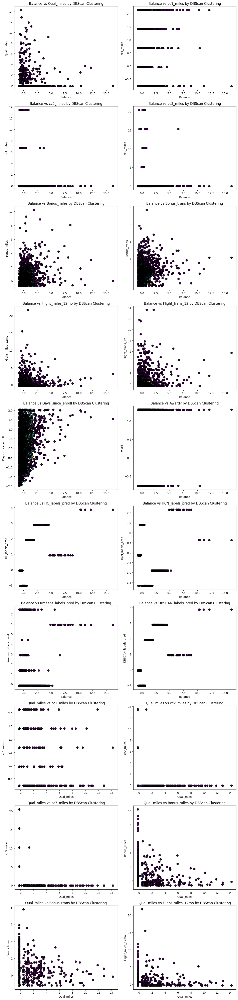

3D plot


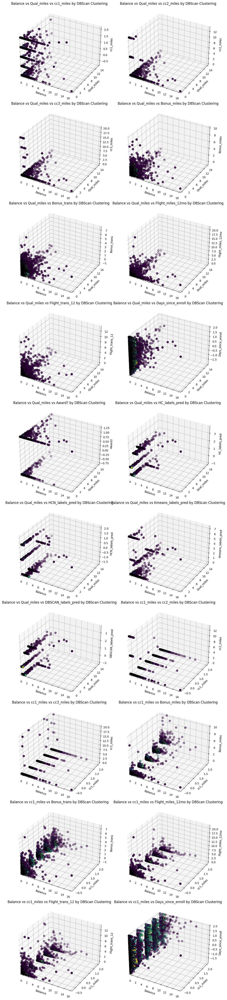

In [27]:
#Plot the clusters
data_columns = df.columns[df.columns != cluster_column]

num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows))

count=0
for i, col1 in enumerate(data_columns):
    for j, col2 in enumerate(data_columns):
        if i != j and i<j :  # Avoid plotting the same column against itself
            row_index = (count) // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            axes[row_index, col_index].scatter(X[:, i], X[:, j], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            # Add cluster labels to each point
            for k, label in enumerate(labels_pred):
                axes[row_index, col_index].text(X[k, i], X[k, j], str(label), fontsize=8, ha='center', va='center')
            axes[row_index, col_index].set_title(f'{col1} vs {col2} by DBScan Clustering')
            axes[row_index, col_index].set_xlabel(col1)
            axes[row_index, col_index].set_ylabel(col2)
            # axes[row_index, col_index].legend()

# Adjust layout
plt.tight_layout()
plt.show()


# 3D plot
print("3D plot")
num_columns = len(data_columns)
num_rows = int(np.ceil(min(comb(num_columns, 2),20) / 2))  # Ensure an even number of columns doesn't leave an empty subplot
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, 5 * num_rows), subplot_kw={'projection': '3d'})

count=0
for i in range(num_columns):
    for j in range(i + 1, num_columns):
        for k in range(j + 1, num_columns):
            row_index = count // 2
            col_index = count % 2
            count+=1
            if count > 20:
                break 

            # 3D Scatter plot
            axes[row_index, col_index].scatter(X[:, i], X[:, j], X[:, k], c=labels_pred, cmap='viridis', s=50, edgecolors='k')

            axes[row_index, col_index].set_title(f'{data_columns[i]} vs {data_columns[j]} vs {data_columns[k]} by DBScan Clustering')
            axes[row_index, col_index].set_xlabel(f'{data_columns[i]}')
            axes[row_index, col_index].set_ylabel(f'{data_columns[j]}')
            axes[row_index, col_index].set_zlabel(f'{data_columns[k]}')
            axes[row_index, col_index].set_xlim([np.min(X[:, i]), np.max(X[:, i])])
            axes[row_index, col_index].set_ylim([np.min(X[:, j]), np.max(X[:, j])])
            axes[row_index, col_index].set_zlim([np.min(X[:, k]), np.max(X[:, k])])
            # axes[row_index, col_index].legend()

# Adjust layout
plt.tight_layout()
plt.show()

### silhouette_score -how many clusters were genreated by the algorithm for the respective parameters combinations

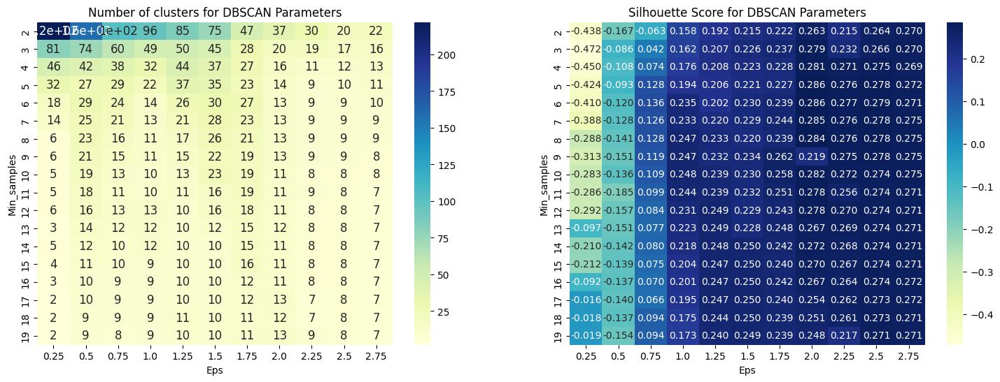

The heatmap on the left illustrates the number of clusters generated by the DBSCAN algorithm for different parameter combinations.
The heatmap on the right shows the corresponding silhouette scores for each parameter combination.


In [28]:
from itertools import product
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

df = new_data
stscaler = StandardScaler()
X = stscaler.fit_transform(df)

eps_values = np.arange(0.25, 3, 0.25)
min_samples = np.arange(2, 20)
DBSCAN_params = list(product(eps_values, min_samples))

no_of_clusters = []
sil_score = []

for p in DBSCAN_params:
    dbscan = DBSCAN(eps=p[0], min_samples=p[1])
    labels = dbscan.fit_predict(X)
    unique_labels = np.unique(labels)

    if len(unique_labels) > 1:
        no_of_clusters.append(len(unique_labels))
        sil_score.append(silhouette_score(X, labels))
    else:
        no_of_clusters.append(-1)
        sil_score.append(0.0)

tmp = pd.DataFrame.from_records(DBSCAN_params, columns=['Eps', 'Min_samples'])
tmp['No_of_clusters'] = no_of_clusters
tmp['Silhouette_score'] = sil_score

pivot_1 = pd.pivot_table(tmp, values='No_of_clusters', index='Min_samples', columns='Eps')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

# Plotting the heatmap for number of clusters
sns.heatmap(pivot_1, annot=True, annot_kws={"size": 12}, cmap="YlGnBu", ax=ax1)
ax1.set_title('Number of clusters for DBSCAN Parameters')
ax1.set_xlabel('Eps')
ax1.set_ylabel('Min_samples')

# Plotting the silhouette score
silhouette_scores = np.array(sil_score).reshape(len(eps_values), len(min_samples)).T
# silhouette_scores = np.array(sil_score).reshape(len(min_samples), len(eps_values))
sns.heatmap(silhouette_scores, annot=True, fmt=".3f", cmap="YlGnBu", ax=ax2, xticklabels=eps_values, yticklabels=min_samples)
ax2.set_title('Silhouette Score for DBSCAN Parameters')
ax2.set_xlabel('Eps')
ax2.set_ylabel('Min_samples')

plt.show()

print('The heatmap on the left illustrates the number of clusters generated by the DBSCAN algorithm for different parameter combinations.')
print('The heatmap on the right shows the corresponding silhouette scores for each parameter combination.')


In [29]:
data_filtered

,Balance,Qual_miles,cc1_miles,cc2_miles,cc3_miles,Bonus_miles,Bonus_trans,Flight_miles_12mo,Flight_trans_12,Days_since_enroll,Award?,labels_pred,HC_labels_pred,HCN_labels_pred,Kmeans_labels_pred,DBSCAN_labels_pred
ID#,,,,,,,,,,,,,,,,
1,28143,0,1,1,1,174,1,0,0,7000,0,0,2,0,1,0
2,19244,0,1,1,1,215,2,0,0,6968,0,0,2,0,1,0
3,41354,0,1,1,1,4123,4,0,0,7034,0,0,2,0,1,0
4,14776,0,1,1,1,500,1,0,0,6952,0,0,2,0,1,0
5,97752,0,4,1,1,43300,26,2077,4,6935,1,-1,4,0,0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4017,18476,0,1,1,1,8525,4,200,1,1403,1,1,2,0,1,1
4018,64385,0,1,1,1,981,5,0,0,1395,1,2,4,0,0,2
4019,73597,0,3,1,1,25447,8,0,0,1402,1,2,4,0,0,2
